Imports

In [14]:
import sys
import os
import numpy as np
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

repo_root = "/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/"
if repo_root not in sys.path:
    sys.path.insert(0, repo_root)

import psp

# Reload the package
import sys
# Remove the main package if it's in sys.modules
if 'psp' in sys.modules:
    del sys.modules['psp']

# Remove any submodules of psp
for mod in list(sys.modules.keys()):
    if mod.startswith('psp.'):
        del sys.modules[mod]
import psp

import anndata as ad
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import scperturb as scp
from scipy.spatial.distance import squareform, pdist
from tqdm_joblib import tqdm_joblib
from scipy.stats import spearmanr
from joblib import Parallel, delayed
from joblib import parallel_backend
from tqdm.auto import tqdm
from scipy import sparse
import SEACells

Reading in data and applying feature selection using the same parameters as Replogle et al. They choose the top 10 DEGs per perturbation, but in this case we choose to do the top 5 up and top 5 down DEGs per perturbation as identified by DESeq2 with L2FC > 2 and top 10% of HVGs

In [2]:
adata = psp.utils.read_anndata("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/KOLF_Pan_Genome_Energy_Test_Gene_Level_DEG_Etest_Filtered.h5ad")
adata.X = adata.layers['counts'].copy()
del adata.layers['pre_z_normalization']
DEGs = pd.read_csv('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_DEGs_per_gene.csv')
adata_subset = psp.da.replogle_pipeline(adata, DEGs, l2fc_threshold = 2, pct_hvgs = 10)
bulks_all = psp.da.bulk_by_gene_target_mean(adata) #computing psuedobulk profiles for all perturbations
bulks_subset = psp.da.bulk_by_gene_target_mean(adata_subset) #computing psuedobulk profiles for perturbations subset to the selected genes

/scratch/ydoctor/job_5962753/ipykernel_773817/3440522384.py:4: DtypeWarning: Columns (3,6,9,12,15,18,21,24,27,30,33,36,39,42,45,48,51,54,57,60,63,66,69,72,75,78,81,84,87,90,93,96,99,102,105,108,111,114,117,120,123,126,129,132,135,138,141,144,147,150,153,156,159,162,165,168,171,174,177,180,183,186,189,192,195,198,201,204,207,210,213,216,219,222,225,228,231,234,237,240,243,246,249,252,255,258,261,264,267,270,273,276,279,282,285,288,291,294,297,300,303,306,309,312,315,318,321,324,327,330,333,336,339,342,345,348,351,354,357,360,363,366,369,372,375,378,381,384,387,390,393,396,399,402,405,408,411,414,417,420,423,426,429,432,435,438,441,444,447,450,453,456,459,462,465,468,471,474,477,480,483,486,489,492,495,498,501,504,507,510,513,516,519,522,525,528,531,534,537,540,543,546,549,552,555,558,561,564,567,570,573,576,579,582,585,588,591,594,597,600,603,606,609,612,615,618,621,624,627,630,633,636,639,642,645,648,651,654,657,660,663,666,669,672,675,678,681,684,687,690,693,696,699,702,705,708,711,71

Minimum median NTC UMI count: 4312.0 from batch GAMMA
 Normalizing to 4312.0 UMIs per cell
normalizing counts per cell
    finished (0:00:03)
Applying relative z-normalization per batch
Identified 1108 unique genes that are the union of the top 5 and bottom 5 DEGs per perturbation
Identifying HVGs
Genes with more than mean 0.25 UMIs: 3619
Genes in the top 30th percent of variance: 3861
Total HVGs: 1269
Building a feature set of 2190 genes, comprising of the union of 1108 DEGs and 1269 HVGs.


Making correlation matrix

In [2]:
adata_subset = ad.read_h5ad('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_Feature_Selected.h5ad')

Computing mean profiles:   0%|          | 0/1656 [00:00<?, ?it/s]

183 CORUM complexes present
Mann-Whitney U statistic: 2221120008.0, p-value: 0.0


Computing mean profiles:   0%|          | 0/1656 [00:00<?, ?it/s]

81 CORUM complexes present
Mann-Whitney U statistic: 3165692135.0, p-value: 0.0


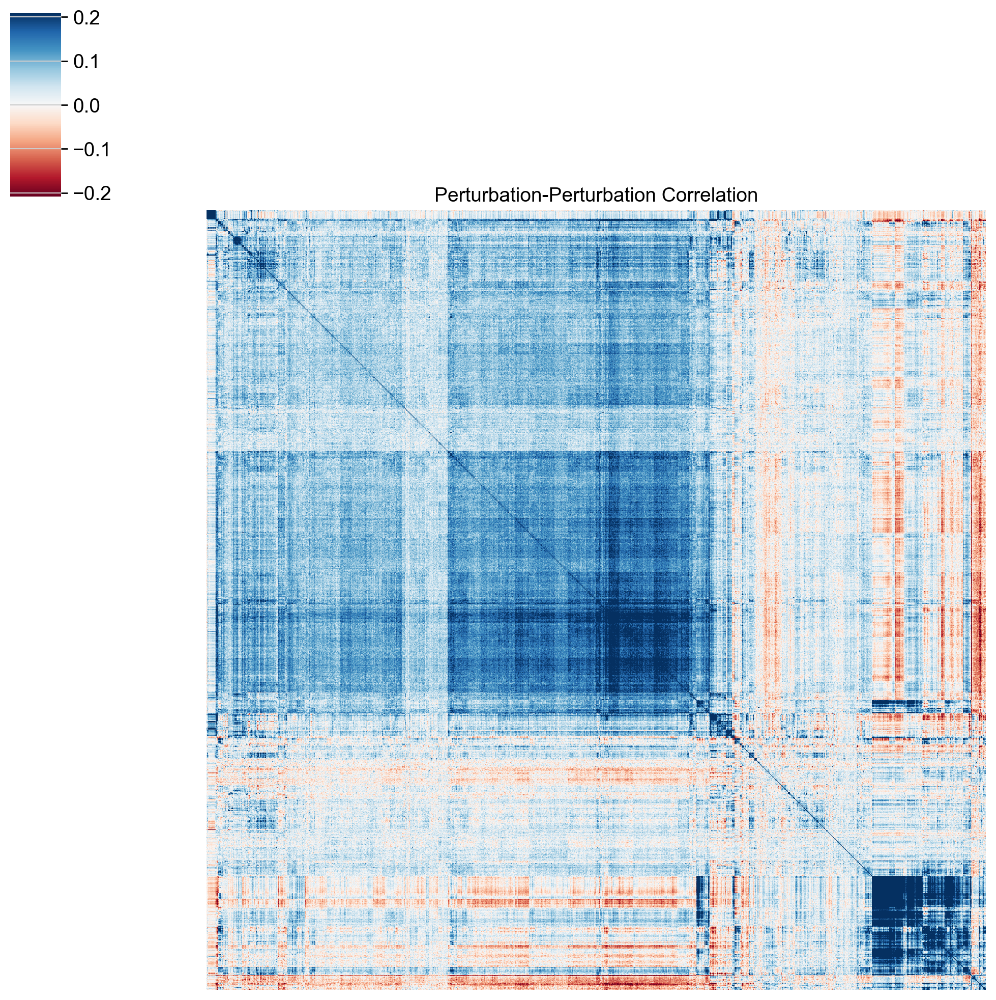

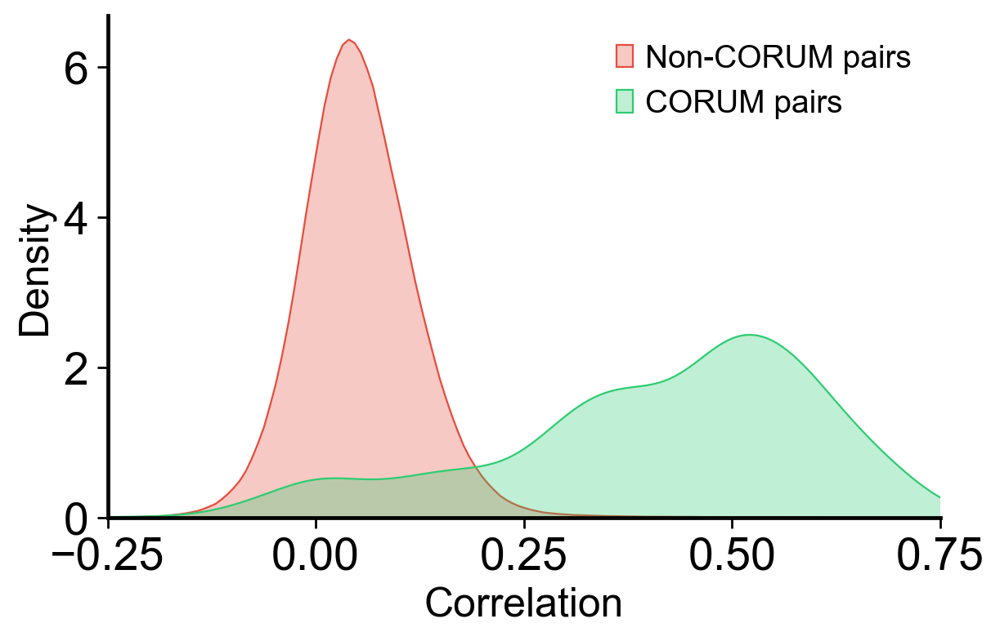

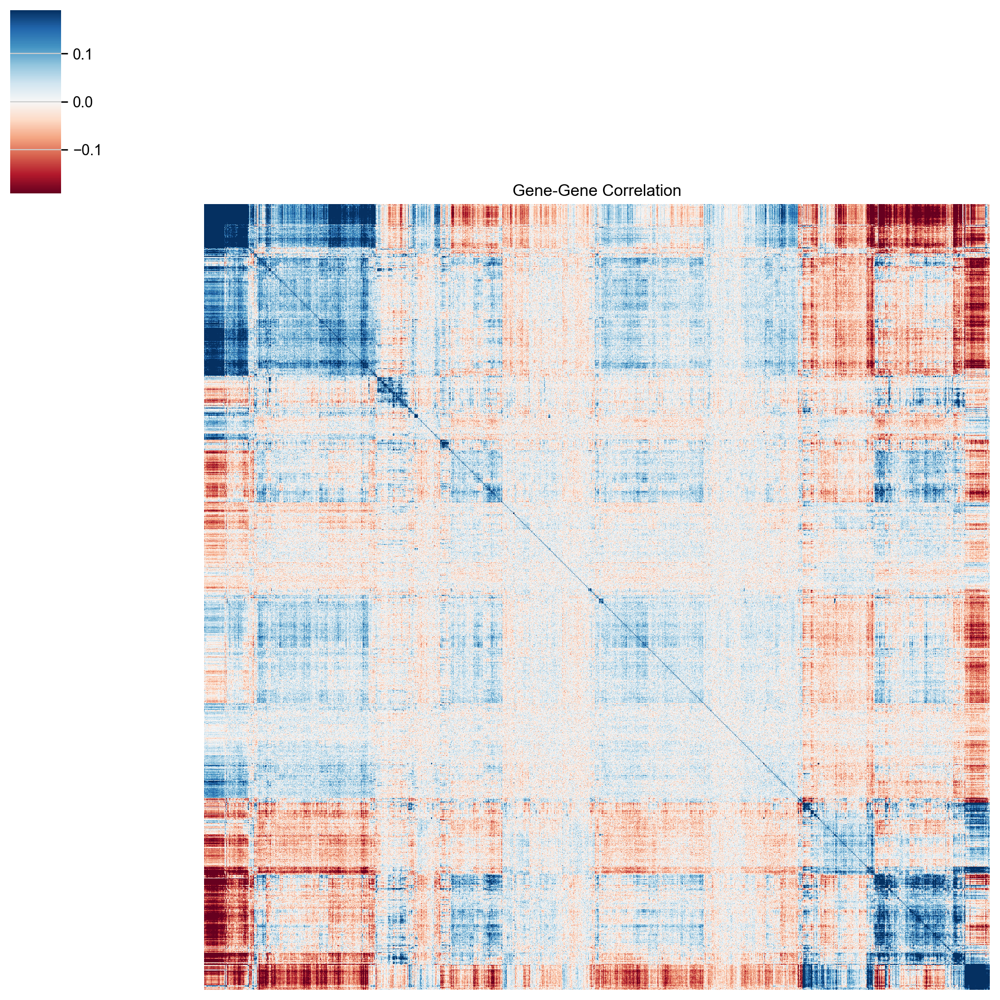

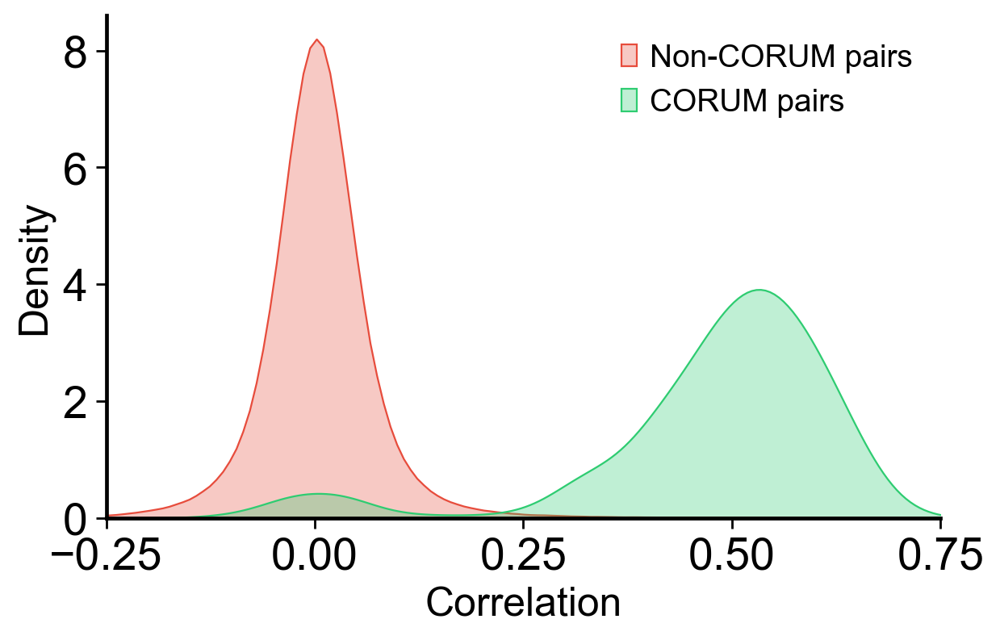

In [15]:
import json
with open('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/analysis_scripts/investigations/CORUM5.1_physical_interactors.json', 'r') as f:
    corum_complexes = json.load(f)
fig, perturb_corrs, mp = psp.da.create_corrmatrix(adata_subset,title='Perturbation-Perturbation Correlation', mode='perturb')
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Perturbation_Perturbation_Correlation.png', dpi=1200)
corum, non_corum = psp.da.get_corum_perturbation_pairs_from_list(perturb_corrs.columns.unique(), corum_complexes)
fig, u_stat, p_value = psp.da.benchmark_corum_vs_noncorum_pairs(perturb_corrs, corum, non_corum)
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Perturbation_Perturbation_Correlation_Corum_vs_NonCorum_Benchmark.svg')

fig, gene_corrs, mp = psp.da.create_corrmatrix(adata_subset,title='Gene-Gene Correlation', mode='gene')
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Gene_Gene_Correlation.png', dpi=1200)
corum_genes, non_corum_genes = psp.da.get_corum_perturbation_pairs_from_list(gene_corrs.index.unique(), corum_complexes)
fig, u_stat, p_value = psp.da.benchmark_corum_vs_noncorum_pairs(gene_corrs, corum_genes, non_corum_genes)
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Gene_Gene_Correlation_Corum_vs_NonCorum_Benchmark.svg')
perturb_corrs.to_csv('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Perturbation_Perturbation_Correlation.csv')
gene_corrs.to_csv('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Gene_Gene_Correlation.csv')

Applying HDBSCAN to cluster

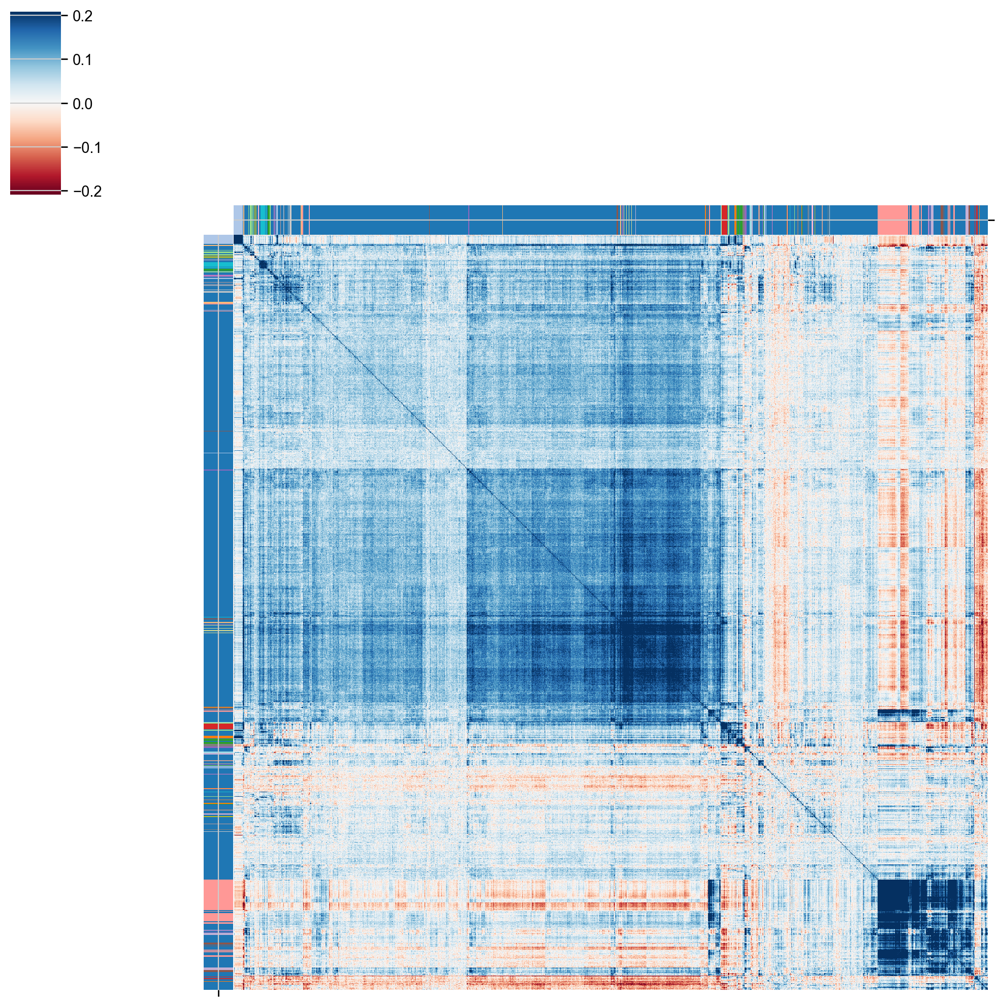

HDBSCAN Found 30 Clusters
Correlation matrix on only genes assigned a HDBScan Cluster: 314 total genes


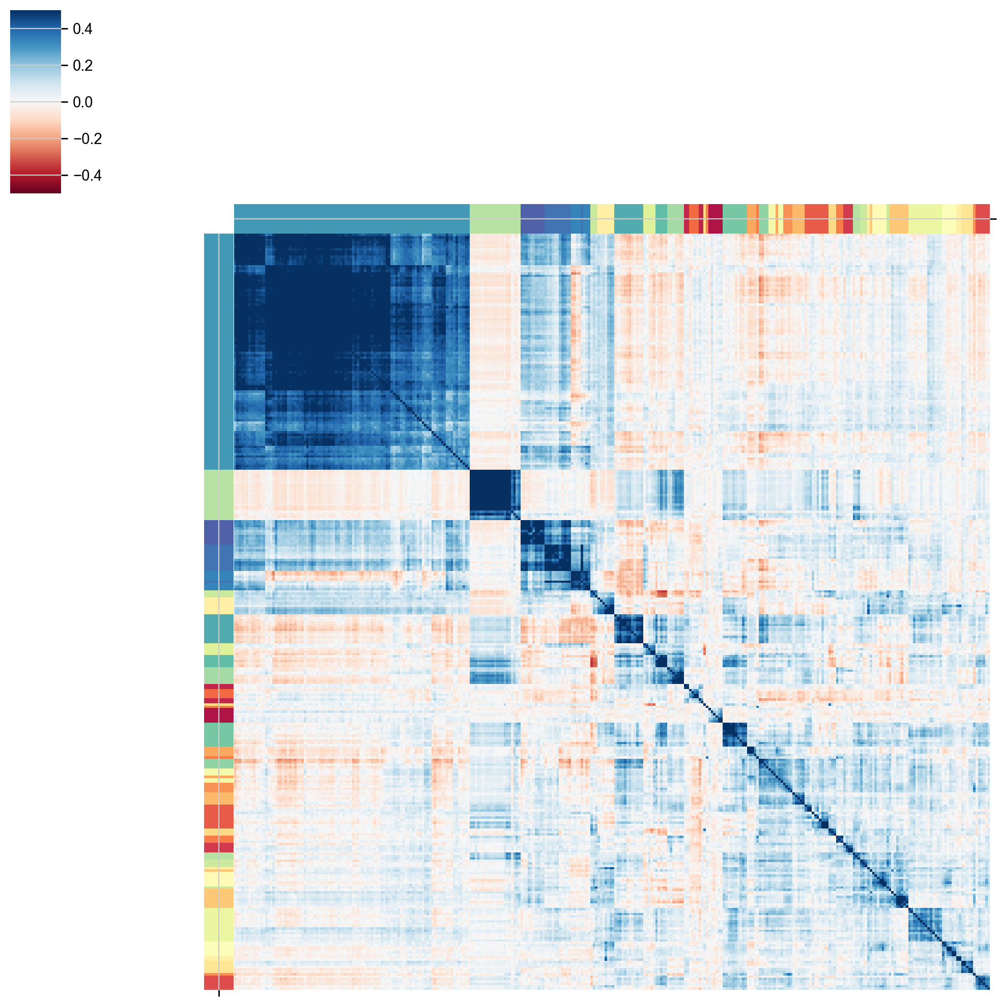

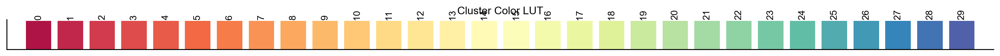

In [5]:
from sklearn.cluster import HDBSCAN
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd

clusterer = HDBSCAN(metric='precomputed', min_cluster_size=4, cluster_selection_method='eom', min_samples=1)
fig1, fig2, perturbation_HDBSCAN_labels = psp.da.compute_HDBSCAN_clusters(perturb_corrs, clusterer)
fig1.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Perturbation_Perturbation_Correlation_HDBSCAN_Clusters_Computed.png', dpi=1200)
fig2.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Perturbation_Perturbation_Correlation_HDBSCAN_Clusters_Only_Clustermap.png', dpi=1200)

Jun 20 11:02:43 AM: Fitting a centered embedding into R^20, for a graph with 2189 items and 85234 edges.
Jun 20 11:02:43 AM: `embed` method parameters: eps=1.0e-09, max_iter=1000, memory_size=10
Jun 20 11:02:45 AM: iteration 0000 | distortion 0.261282 | residual norm 0.00167657 | step length 3030 | percent change 2.42788
Jun 20 11:04:02 AM: iteration 0100 | distortion 0.176863 | residual norm 0.00026852 | step length 1 | percent change 0.699356
Jun 20 11:05:14 AM: iteration 0200 | distortion 0.175672 | residual norm 0.000118467 | step length 1 | percent change 0.484485
Jun 20 11:06:29 AM: iteration 0300 | distortion 0.175345 | residual norm 3.72353e-05 | step length 1 | percent change 0.138077
Jun 20 11:07:40 AM: iteration 0400 | distortion 0.175310 | residual norm 1.73958e-05 | step length 1 | percent change 0.040428
Jun 20 11:08:53 AM: iteration 0500 | distortion 0.175303 | residual norm 1.15197e-05 | step length 1 | percent change 0.0536582
Jun 20 11:10:13 AM: iteration 0600 | disto

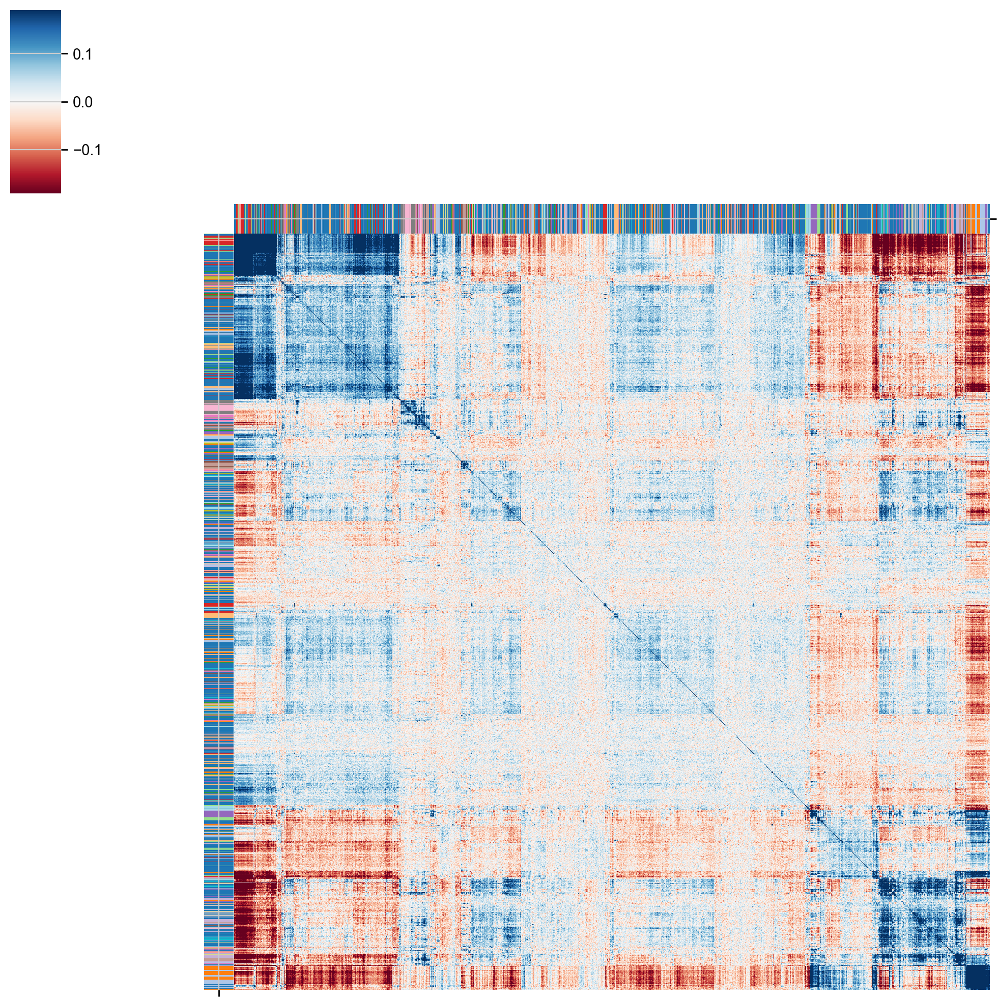

HDBSCAN Found 47 Clusters
Correlation matrix on only genes assigned a HDBScan Cluster: 1140 total genes


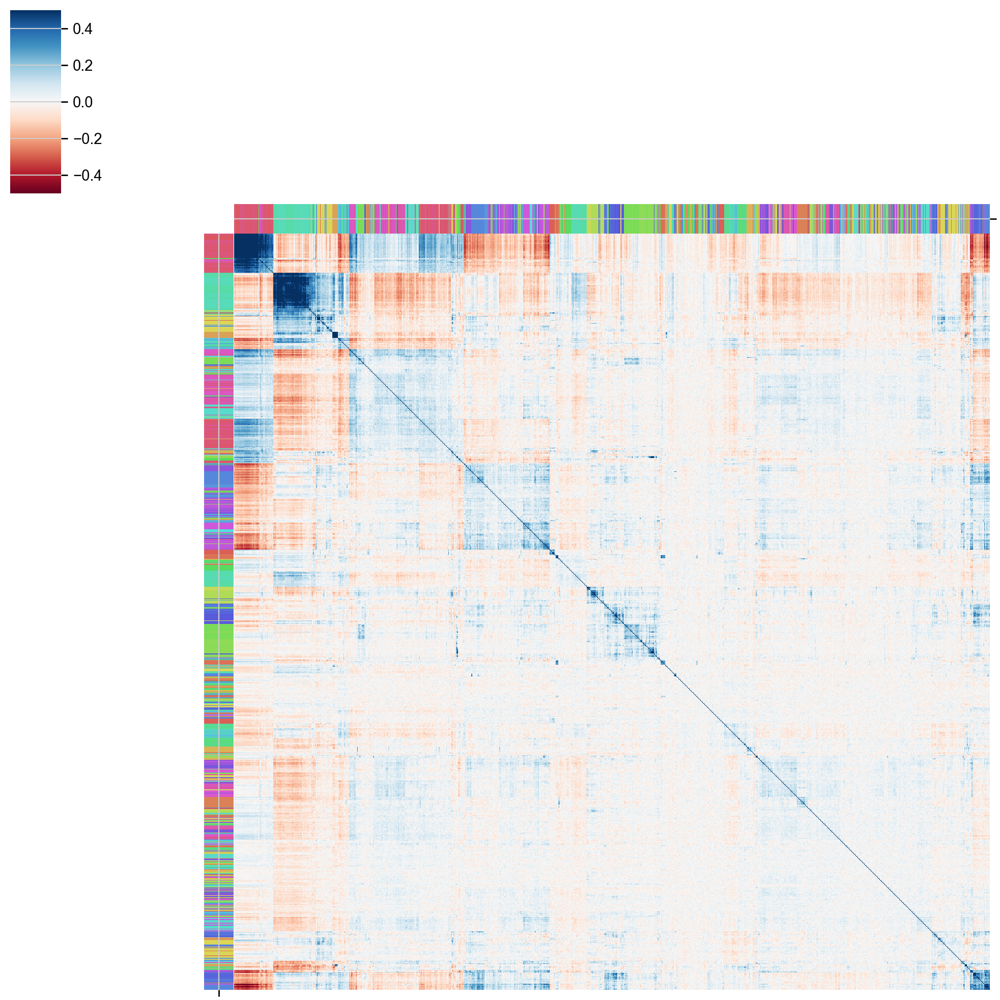

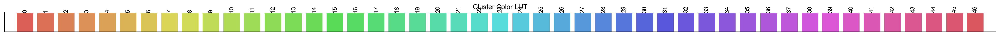

In [6]:
# here letting min_cluster_size = 5 to allow for more clusters
from sklearn.cluster import HDBSCAN
clusterer = HDBSCAN(metric='euclidean', min_cluster_size=10, cluster_selection_method='leaf', min_samples=1)
fig1, fig2, gene_HDBSCAN_labels = psp.da.compute_HDBSCAN_clusters_20d_embedding(bulks_subset, gene_corrs, clusterer)
fig1.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Gene_Gene_Correlation_HDBSCAN_Clusters_Computed.png', dpi=1200)
fig2.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Gene_Gene_Correlation_HDBSCAN_Clusters_Only_Clustermap.png', dpi=1200)

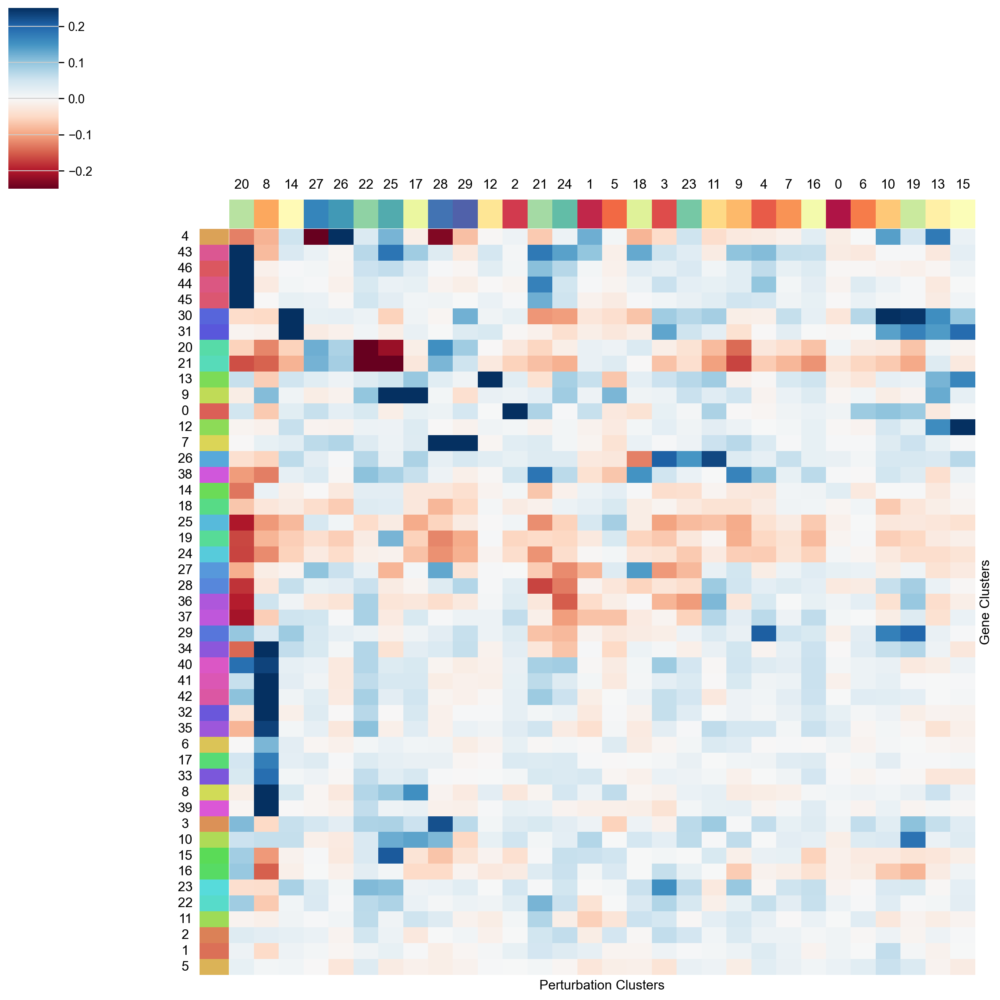

In [7]:
psp.da.plot_pert_gene_summary_heatmap(gene_HDBSCAN_labels, perturbation_HDBSCAN_labels, mp, vmin = -0.25, vmax = 0.25)

In [8]:
mp_standardized = psp.da.standardize(mp, axis=0)

from sklearn.manifold import SpectralEmbedding
import pymde
def embed_spectral_mde(mp_standardized, n_components = 20,n_neighbors = 7, random_state = 42, repulsive_fraction = 5):
    embedder = SpectralEmbedding(
        n_components=n_components,
        affinity='nearest_neighbors',
        eigen_solver='arpack',
        random_state=random_state,
        n_neighbors = 25
    )
    X = embedder.fit_transform(mp_standardized)
    pymde.seed(random_state)
    mde = pymde.preserve_neighbors(X, embedding_dim=2, n_neighbors=n_neighbors,repulsive_fraction=repulsive_fraction)
    Y = mde.embed(verbose=True, eps=1e-9, max_iter=2000)
    return Y

mde_embedding = embed_spectral_mde(mp_standardized, n_neighbors = 7, repulsive_fraction = 10)

Jun 20 11:17:39 AM: Fitting a centered embedding into R^2, for a graph with 1656 items and 94433 edges.
Jun 20 11:17:39 AM: `embed` method parameters: eps=1.0e-09, max_iter=2000, memory_size=10
Jun 20 11:17:41 AM: iteration 0000 | distortion 1.161884 | residual norm 0.167995 | step length 0.823515 | percent change 0.240393
Jun 20 11:17:44 AM: iteration 0200 | distortion 0.077261 | residual norm 5.54893e-05 | step length 1 | percent change 0.192593
Jun 20 11:17:46 AM: iteration 0400 | distortion 0.076398 | residual norm 3.64655e-05 | step length 1 | percent change 0.0856481
Jun 20 11:17:49 AM: iteration 0600 | distortion 0.076285 | residual norm 3.21249e-05 | step length 1 | percent change 0.161492
Jun 20 11:17:51 AM: iteration 0800 | distortion 0.076168 | residual norm 1.9273e-05 | step length 1 | percent change 0.0355733
Jun 20 11:17:53 AM: iteration 1000 | distortion 0.076138 | residual norm 2.1083e-05 | step length 1 | percent change 0.135429
Jun 20 11:17:56 AM: iteration 1200 | dis

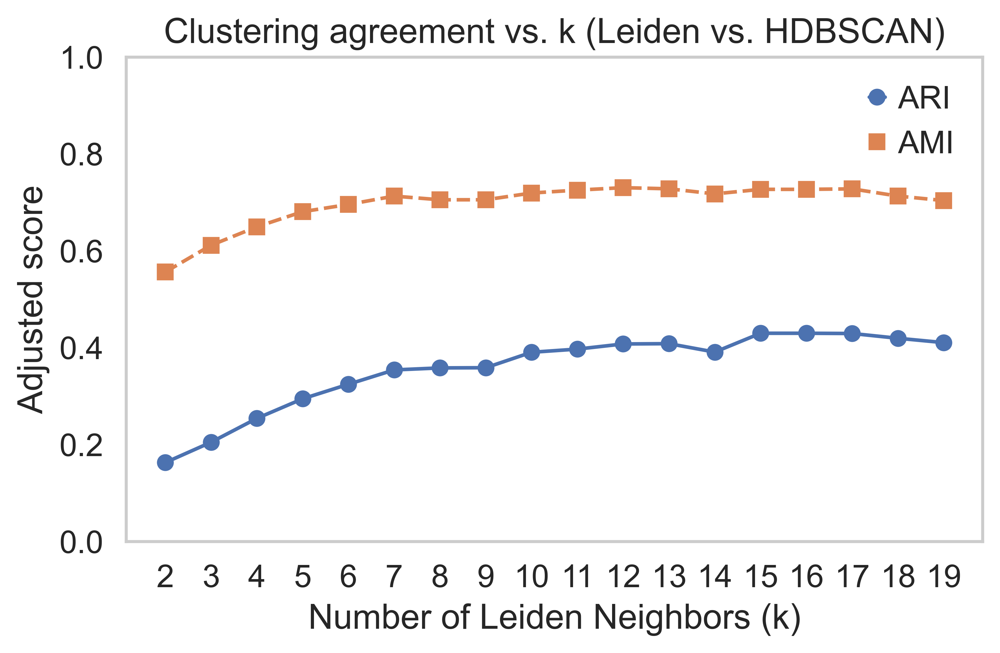

In [179]:
psp.da.plot_cluster_agreement(mde_embedding, perturbation_HDBSCAN_labels)

249 CORUM complexes present


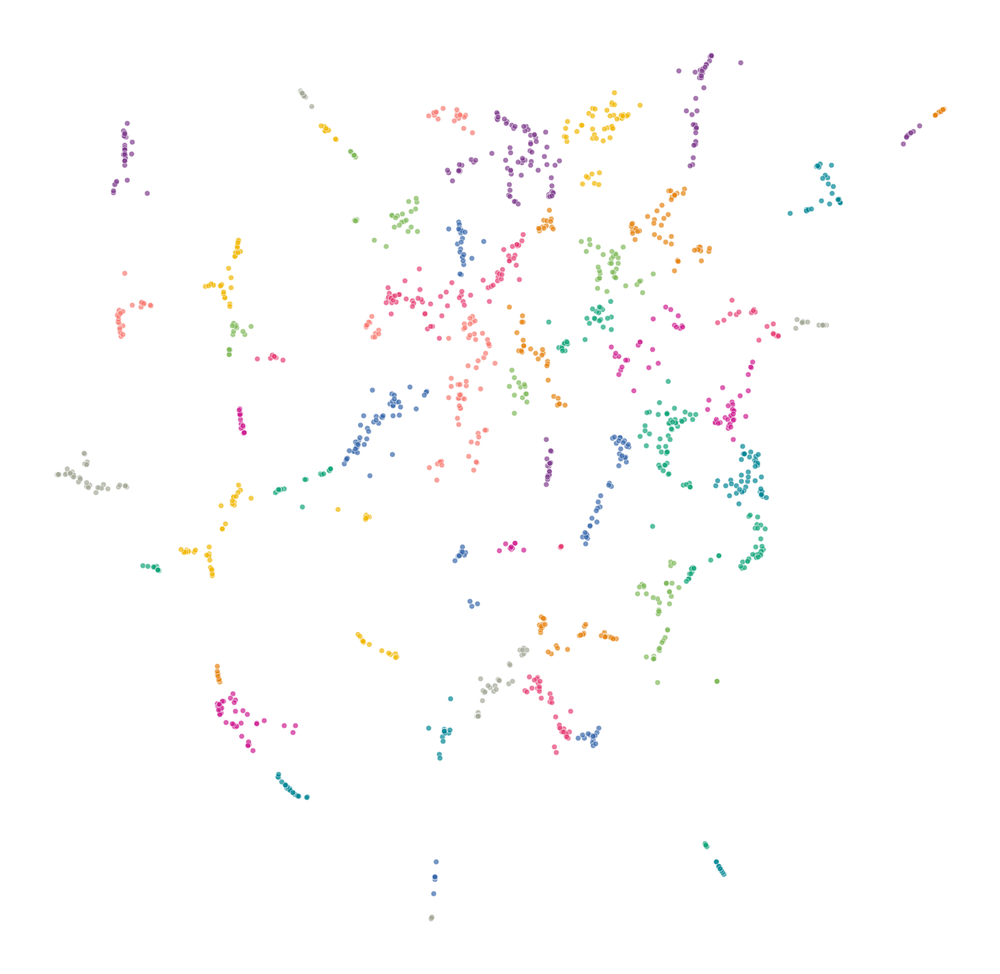

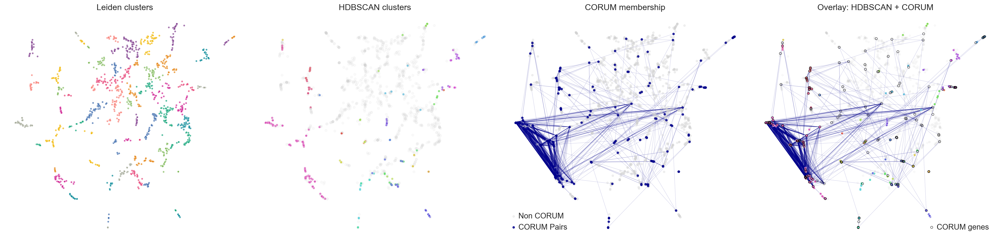

In [194]:
embedding_df = psp.da.plot_mde(mde_embedding, perturbation_HDBSCAN_labels, bulks_subset, n_neighbors = 7, corum_complexes = corum_complexes, save_dir_stem = '/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified')

Normalized Mean CORUM pair distance    : 0.4673
Normalized Mean non-CORUM pair distance: 1.0007
Distance ratio (NON:CORUM)   : 2.1415


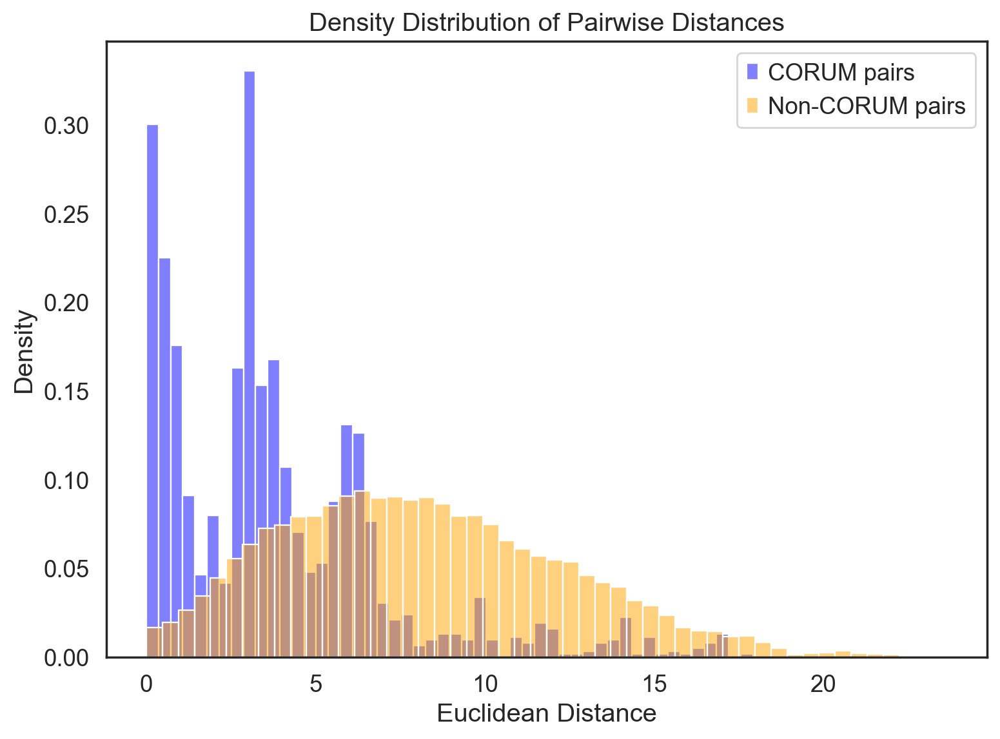

In [197]:
psp.da.plot_corum_distances(embedding_df, corum)

In [198]:
output_path = '/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_MDE_clusters_annotated.xlsx'
leiden_annotated, hdbscan_annotated = psp.da.annotate_clusters(embedding_df, output_path = output_path)

In [199]:
leiden_annotated.head()

,leiden cluster,gene_list,CORUM_Links_Annotation,CORUM_Annotation,KEGG_2021_Human_Annotation,GO_Biological_Process_2025_Annotation,GO_Molecular_Function_2025_Annotation,GO_Cellular_Component_2025_Annotation,Reactome_Pathways_2024_Annotation
0,0,"ADO,ADSL,AP1S2,ARHGAP1,BAX,C7orf25,CALU,CAND2,...",BAX homo-oligomer complex,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment
1,1,"AKAP12,ASPHD2,ATM,BBS10,C5orf22,CAPN5,CBR4,CDK...",ATM homodimer; TLR7-receptor complex,No significant enrichment,No significant enrichment,Intracellular Signaling Cassette (GO:0141124),No significant enrichment,No significant enrichment,No significant enrichment
2,2,"AGA,AKAP17A,AMMECR1L,ARAP3,ARHGDIA,ART5,ATP5MC...",ELOB-ELOC-VHL complex,ITGA3-ITGB1-BSG complex (human); VHL-TBP1-HIF1...,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment
3,3,"AGMAT,AGTRAP,ALDH6A1,BTBD6,C6orf226,C16orf86,C...",TRAF6 homo-oligomer complex,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment
4,4,"ACOT8,ARF4,BCL2L13,BST2,C1orf74,C1orf198,C17or...",No links,GluR6a-GluR6b-KA2 complex (mouse); ERBB2-MEMO-...,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment


In [200]:
hdbscan_annotated.head()

,hdbscan cluster,gene_list,CORUM_Links_Annotation,CORUM_Annotation,KEGG_2021_Human_Annotation,GO_Biological_Process_2025_Annotation,GO_Molecular_Function_2025_Annotation,GO_Cellular_Component_2025_Annotation,Reactome_Pathways_2024_Annotation
0,0,"AP2M1,AP2S1,ATOX1,NSG1,NUP43,SLC30A1",No links,Nup 107-160 subcomplex (human),Endocrine and other factor-regulated calcium r...,Synaptic Vesicle Endocytosis (GO:0048488); Pre...,Clathrin Adaptor Activity (GO:0035615); Clathr...,AP-2 Adaptor Complex (GO:0030122); Clathrin Co...,Retrograde Neurotrophin Signalling; Nef Mediat...
1,1,"ELOF1,LEO1,SLC9A5,SUPT4H1",No links,Paf complex (human); DSIF complex (DRB sensiti...,No significant enrichment,DNA-templated Transcription Elongation (GO:000...,RNA Polymerase II Complex Binding (GO:0000993)...,Cdc73/Paf1 Complex (GO:0016593); Neuron Spine ...,Formation of RNA Pol II Elongation Complex; RN...
2,2,"ACTB,CAP1,CAPZB,CYB5R3",ACTB-CAP1-CFL1 complex,Cofilin-actin-CAP1 complex (human); RICH1/AMOT...,No significant enrichment,Positive Regulation of Adenylate Cyclase Activ...,Actin Binding (GO:0003779); Nitrite Reductase ...,Azurophil Granule Lumen (GO:0035578); Vacuolar...,Sensory Processing of Sound; Sensory Processin...
3,3,"MAU2,METTL7B,NIPBL,RAD21,SMC1A,STAG2",Cohesin-SA2 complex; MAU2-NIPBL complex; NIPBL...,Cohesin-SA2 complex (human); SNF2h-cohesin-NuR...,Cell cycle; Oocyte meiosis,Mitotic Sister Chromatid Cohesion (GO:0007064)...,Chromo Shadow Domain Binding (GO:0070087),Chromosome (GO:0005694); Intracellular Membran...,Mitotic Telophase Cytokinesis; Cohesin Loading...
4,4,"ARID1A,EZH2,EZR,PCGF1,PKNOX2,SMARCB1,SMARCC1,S...",BRD7-EZH2-SUZ12 complex,SWI-SNF chromatin remodeling-related-BRCA1 com...,Hepatocellular carcinoma; Thermogenesis; Micro...,Regulation of Cell Cycle G1/S Phase Transition...,Nucleosomal DNA Binding (GO:0031492); RNA Poly...,nBAF Complex (GO:0071565); npBAF Complex (GO:0...,Regulation of MITF-M-dependent Genes Involved ...


In [201]:
gene_df = pd.DataFrame(dict(gene_HDBSCAN_labels).items(),columns = ['gene_target','hdbscan cluster'], index = gene_HDBSCAN_labels.index)
gene_df.index.name = 'gene_target'
output_path = '/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_gene_clusters_annotated.xlsx'
hdbscan_annotated = psp.da.annotate_clusters(gene_df, output_path = output_path, cluster_cols = ['hdbscan cluster'])[0]

In [202]:
hdbscan_annotated.head()

,hdbscan cluster,gene_list,CORUM_Links_Annotation,CORUM_Annotation,KEGG_2021_Human_Annotation,GO_Biological_Process_2025_Annotation,GO_Molecular_Function_2025_Annotation,GO_Cellular_Component_2025_Annotation,Reactome_Pathways_2024_Annotation
0,0,"S100A10,ACTG2,ENSG00000237844,NECTIN3-AS1,LPP,...",Purine nucleoside phosphorylase,TRPV5-S100A10-annexin 2 complex (mouse); S100A...,Salmonella infection; Hypertrophic cardiomyopa...,Myofibril Assembly (GO:0030239); Actin Filamen...,Myosin Binding (GO:0017022); Actin Binding (GO...,Actin Cytoskeleton (GO:0015629); Cytoskeleton ...,Smooth Muscle Contraction; Muscle Contraction;...
1,1,"LHX8,EGLN1,DARS1,IGFBP2,DIRC3,EPHA3,FAM162A,P3...",LDHA homotetramer,Prolyl 4-hydroxylase (alpha(I)-type) (human); ...,Glycolysis / Gluconeogenesis; HIF-1 signaling ...,ADP Catabolic Process (GO:0046032); Carbohydra...,Procollagen-Proline Dioxygenase Activity (GO:0...,No significant enrichment,No significant enrichment
2,2,"LIN28A,DR1,ASPM,NUCKS1,CENPF,TFG,CEP70,DHX36,S...",RalBP1-CDC2-CCNB1 complex; WASL homomer; CCNB1...,RalBP1-CDC2-CCNB1 complex (human); CCNB1-CDC2 ...,Oocyte meiosis; Progesterone-mediated oocyte m...,Mitotic Spindle Organization (GO:0007052); Reg...,Histone Deacetylase Binding (GO:0042826); Micr...,Spindle (GO:0005819); Mitotic Spindle (GO:0072...,Mitotic G2-G2 M Phases; G2 M Transition; Cell ...
3,3,"JUN,NTNG1,NES,TENM3-AS1,CASP3,CWC27,CREB5,AK3,...",No links,SMAD3-SMAD4-cJUN complex (human); SMAD3-SMAD4-...,TNF signaling pathway; IL-17 signaling pathway...,Response to Steroid Hormone (GO:0048545),cAMP Response Element Binding (GO:0035497); Se...,Transcription Factor AP-1 Complex (GO:0035976)...,Caspase Activation via Dependence Receptors in...
4,4,"ARF4,CDK2AP2,ENSG00000289901,MT-ND1,MT-ND2,MT-...",Respiratory chain complex I (incomplete interm...,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment,No significant enrichment,FASTK Family Proteins Regulate Processing and ...


In [ ]:
adata_subset.write_h5ad('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_Feature_Selected.h5ad')

/scratch/ydoctor/job_6258854/ipykernel_1982850/2393642855.py:10: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, n_iterations = 2, resolution = 1.5)


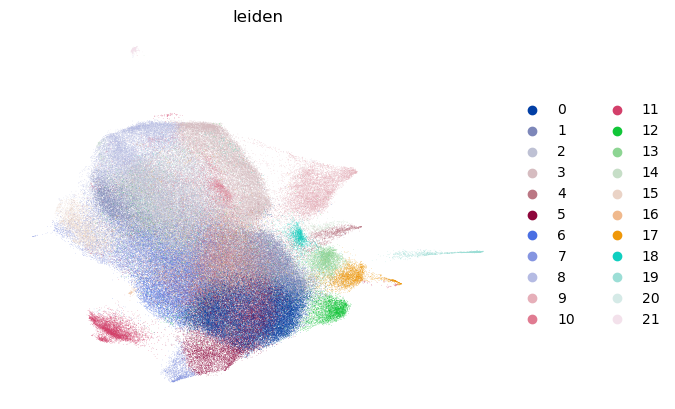

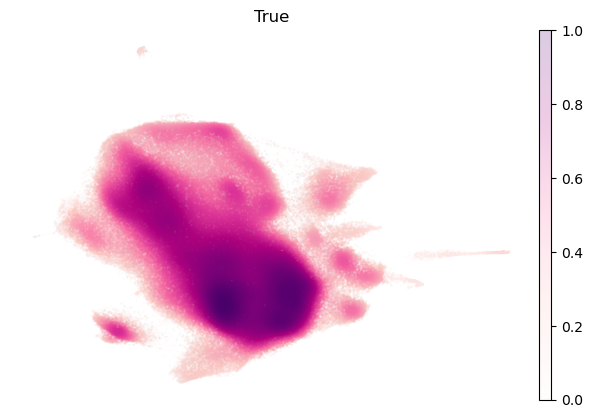

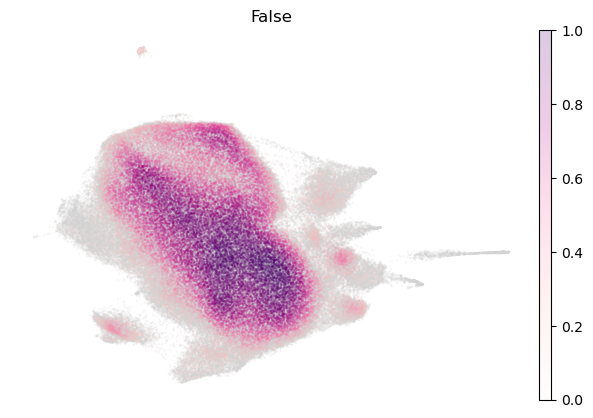

In [1]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

adata = sc.read_h5ad('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_Feature_Selected.h5ad')
sc.pp.pca(adata, n_comps=50)
sc.pp.neighbors(adata, use_rep = 'X_pca')
sc.tl.umap(adata, min_dist = 0.1, spread = 1.5)
sc.tl.leiden(adata, n_iterations = 2, resolution = 1.5)
sc.pl.umap(adata, color = 'leiden', frameon = False)
sc.tl.embedding_density(adata, groupby='perturbed')
sc.pl.embedding_density(adata, groupby='perturbed', group="True", frameon = False, fg_dotsize=10, color_map='RdPu', bg_dotsize=10, alpha=0.2)
sc.pl.embedding_density(adata, groupby='perturbed', group="False", frameon = False, fg_dotsize=10, color_map='RdPu', bg_dotsize=10, alpha=0.2)


In [7]:
import pandas as pd
embedding_df = pd.read_excel('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_MDE_clusters.xlsx')
embedding_df.head()
gene_target_to_cluster = dict(embedding_df.groupby('gene_target')['hdbscan cluster'].apply(lambda x: x.iloc[0]))
adata.obs['hdbscan_cluster'] = adata.obs['gene_target'].map(gene_target_to_cluster)
adata.obs['hdbscan_cluster'] = adata.obs['hdbscan_cluster'].astype(str)
sc.tl.embedding_density(adata, groupby='hdbscan_cluster')

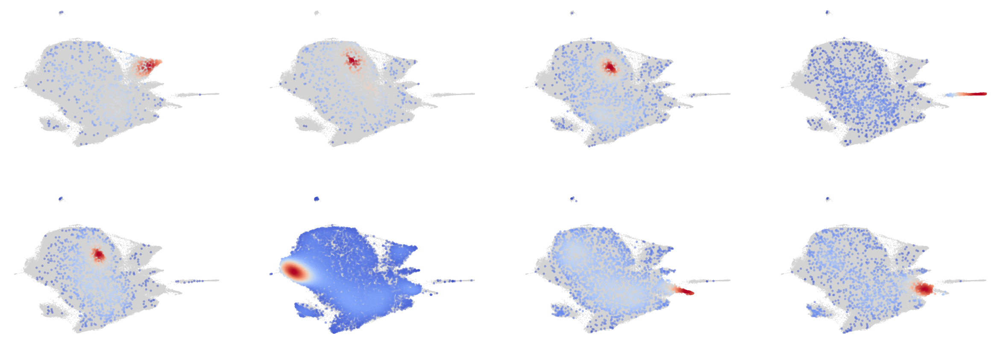

In [33]:
# Get the figure and axes objects by setting show=False and specify a less wide figsize
fig = sc.pl.embedding_density(
    adata, 
    groupby='hdbscan_cluster', 
    group=["0","8","17","20","25","26","28","29"], 
    ncols=4, 
    frameon=False, 
    fg_dotsize=60, 
    color_map='coolwarm', 
    bg_dotsize=10, 
    alpha=.5,
    show=False,
)

# Remove titles and colorbars from all axes
if isinstance(fig, plt.Figure):
    axes = fig.get_axes()
else:
    # If fig is a list of axes or similar
    axes = fig

for ax in axes:
    # Remove the title
    ax.set_title("")
    # Remove colorbar if present
    for im in ax.get_images():
        if hasattr(im, 'colorbar') and im.colorbar:
            im.colorbar.remove()
    # Remove colorbar from collections (for scatter)
    for coll in ax.collections:
        if hasattr(coll, 'colorbar') and coll.colorbar:
            coll.colorbar.remove()

# Reduce the space between subplots
if isinstance(fig, plt.Figure):
    fig.subplots_adjust(wspace=0.01, hspace=0.01)  # adjust as needed for minimal spacing
# Save the entire figure (not just a single axis)
if isinstance(fig, plt.Figure):
    fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/HDBSCAN_Embedding_Density.png", dpi=1200, bbox_inches='tight')
elif isinstance(fig, (list, tuple)):
    # If fig is a list of axes, get the parent figure from the first axis
    parent_fig = fig[0].figure
    parent_fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/HDBSCAN_Embedding_Density.png", dpi=1200, bbox_inches='tight')
plt.show()

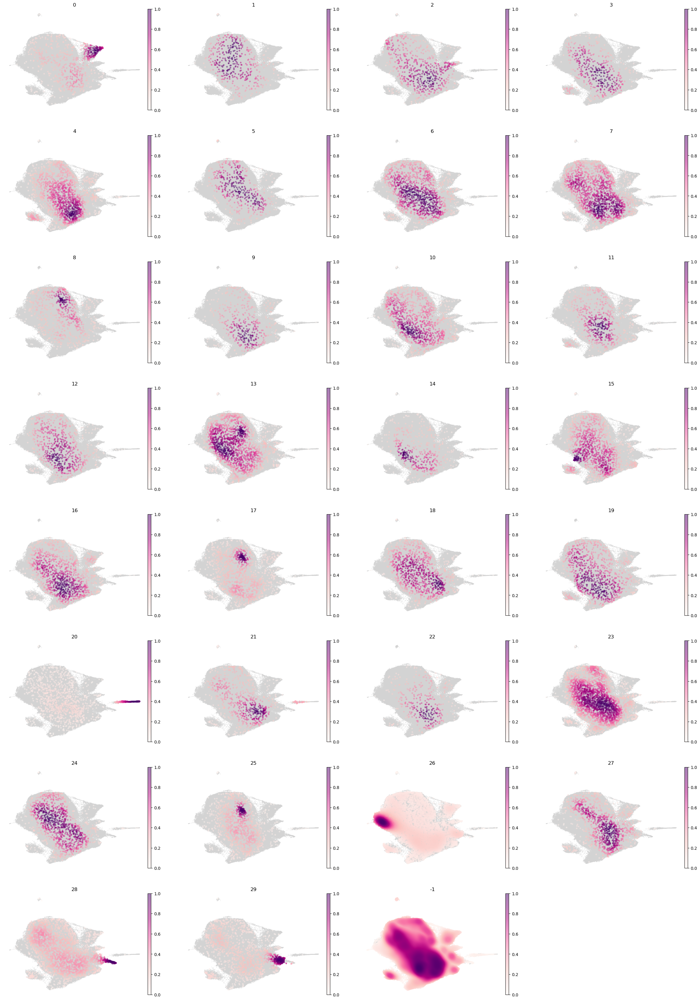

In [17]:
sc.pl.embedding_density(adata, groupby='hdbscan_cluster', ncols=4, frameon = False, fg_dotsize=60, color_map='RdPu', bg_dotsize=10, alpha=.5)

In [15]:
import pandas as pd
embedding_df = pd.read_excel('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_MDE_clusters.xlsx')

In [28]:
import numpy as np

# Get the original cluster assignments and their sizes
cluster_sizes = embedding_df['leiden cluster'].value_counts().sort_index()
n_clusters = cluster_sizes.shape[0]

# Shuffle the cluster assignments randomly, preserving the original cluster sizes
random_clusters = []
for cluster_id, size in zip(cluster_sizes.index, cluster_sizes.values):
    random_clusters.extend([cluster_id] * size)
random_clusters = np.array(random_clusters)
np.random.seed(42)
np.random.shuffle(random_clusters)

# Assign the shuffled clusters to the gene_targets in a random order (not alphabetical)
shuffled_indices = np.random.permutation(len(embedding_df))
random_cluster_df = embedding_df.iloc[shuffled_indices].copy()
random_cluster_df['leiden cluster'] = random_clusters
random_cluster_df = random_cluster_df.reset_index(drop=True)
random_cluster_df

,x,y,gene_target,leiden cluster,hdbscan cluster
0,-9.459838,5.081712,FBXO3,45,-1
1,6.610533,-1.180042,POU3F3,8,-1
2,4.954890,-3.261517,CSKMT,18,-1
3,6.705886,-1.812036,ZNF888,9,-1
4,2.577246,1.820967,TMEM158,39,-1
...,...,...,...,...,...
1651,1.111367,-4.247405,MCM4,28,-1
1652,-6.789970,1.948264,LEFTY2,35,-1
1653,-10.412897,-1.153790,COX4I1,19,-1
1654,-4.907916,6.143472,KIF3B,44,-1


In [29]:
output_path = '/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_MDE_clusters_random_shuffled_annotated.xlsx'
leiden_annotated, hdbscan_annotated = psp.da.annotate_clusters(random_cluster_df, output_path = output_path)

In [30]:
random_clusters_annotated = pd.read_excel('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_MDE_clusters_random_shuffled_annotated.xlsx', sheet_name='leiden cluster')
true_clusters_annotated = pd.read_excel('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_MDE_clusters_annotated.xlsx', sheet_name='leiden cluster')

CORUM_Links_Annotation: p-value = 7.68e-18
CORUM_Annotation: p-value = 8.08e-14
KEGG_2021_Human_Annotation: p-value = 9.47e-39
GO_Biological_Process_2025_Annotation: p-value = 1.58e-322
GO_Molecular_Function_2025_Annotation: p-value = 1.96e-64
GO_Cellular_Component_2025_Annotation: p-value = 1.30e-92
Reactome_Pathways_2024_Annotation: p-value = 1.33e-307


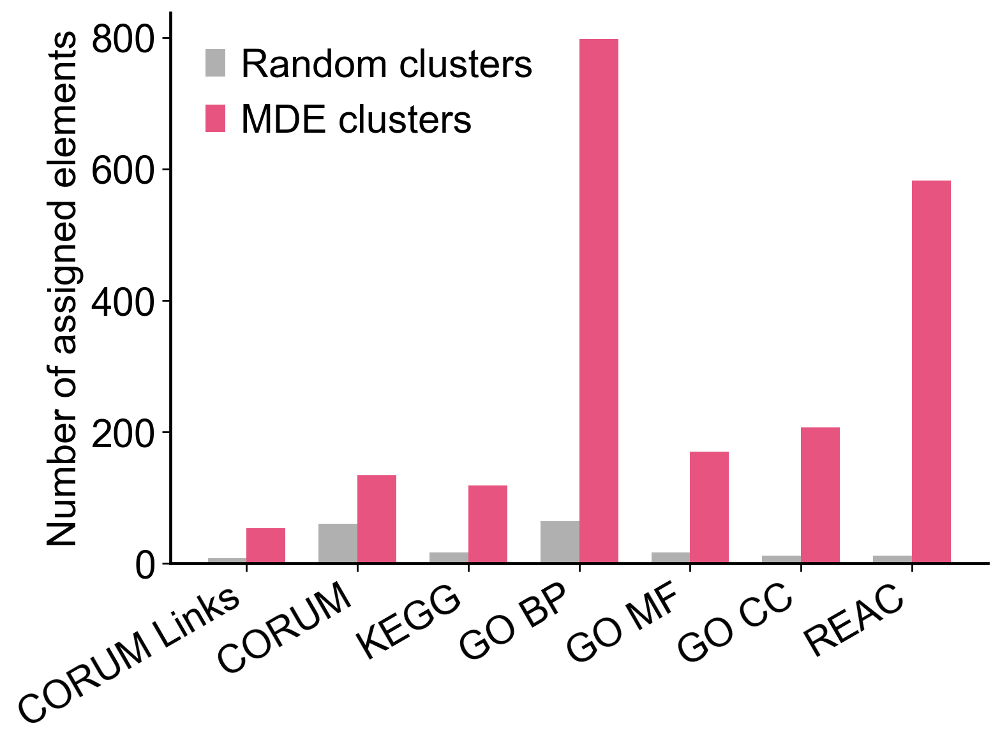

In [60]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import fisher_exact

def count_assigned_elements(df):
    # Exclude 'gene_list' column
    cols = [col for col in df.columns if col not in ['gene_list', 'leiden cluster']]
    counts = {}
    for col in cols:
        # Drop NA and convert to string
        values = df[col].dropna().astype(str)
        # Exclude entries with "homo" (case-insensitive), "No links", or "No significant enrichment"
        filtered = values[
            ~values.str.lower().str.contains("homo") &
            ~values.str.lower().str.contains("mouse") &
            ~values.str.contains("No links", case=False) &
            ~values.str.contains("No significant enrichment", case=False)
        ]
        # Split each cell by ';', strip whitespace, and filter out empty strings
        all_annotations = []
        for entry in filtered:
            annots = [a.strip() for a in entry.split(';') if a.strip() != '']
            all_annotations.extend(annots)
        counts[col] = len(all_annotations)
    return counts

# Get counts for both random and true clusters
random_counts = count_assigned_elements(random_clusters_annotated)
true_counts = count_assigned_elements(true_clusters_annotated)

# Ensure both have the same keys and order
categories = list(random_counts.keys())
random_values = [random_counts[cat] for cat in categories]
true_values = [true_counts[cat] for cat in categories]

# Define new x labels as requested
x_labels_map = {
    "CORUM_Links_Annotation": "CORUM Links",
    "CORUM_Annotation": "CORUM",
    "KEGG_2021_Human_Annotation": "KEGG",
    "GO_Biological_Process_2025_Annotation": "GO BP",
    "GO_Molecular_Function_2025_Annotation": "GO MF",
    "GO_Cellular_Component_2025_Annotation": "GO CC",
    "Reactome_Pathways_2024_Annotation": "REAC"
}
# Map the categories to the new labels, fallback to original if not found
x_labels = [x_labels_map.get(cat, cat) for cat in categories]

# For p-value calculation, we need the total possible assignments per category
n_clusters = len(true_clusters_annotated)
p_values = []

for cat, rand_count, true_count in zip(categories, random_values, true_values):
    total = true_count + rand_count
    a = true_count
    c = rand_count
    b = max(1, total - a)
    d = max(1, total - c)
    contingency = np.array([[a, b], [c, d]])
    _, p = fisher_exact(contingency, alternative='greater')
    p_values.append(p)

# Print out the p-values for each category
for cat, p in zip(categories, p_values):
    print(f"{cat}: p-value = {p:.2e}")

# Bar plot with improved aesthetics, no grid
x = np.arange(len(categories))
width = 0.35

fig, ax = plt.subplots(figsize=(8, 6))
rects1 = ax.bar(x - width/2, random_values, width, label='Random clusters', color='#b0b0b0')
rects2 = ax.bar(x + width/2, true_values, width, label='MDE clusters', color='#e75480')

ax.set_ylabel('Number of assigned elements', fontsize=22)
ax.set_xticks(x)
ax.set_xticklabels(x_labels, rotation=30, ha='right', fontsize=22)
ax.legend(frameon=False, fontsize=22)
ax.tick_params(axis='y', labelsize=22)  # Increased ytick label size here
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.grid(False)

# Make the axes thicker
for spine in ['left', 'bottom']:
    ax.spines[spine].set_linewidth(1.7)

plt.tight_layout()
plt.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Pan_Genome_Filtered_Replogle_Pipeline_Modified_MDE_clusters_random_shuffled_annotated_barplot.svg')
plt.show()

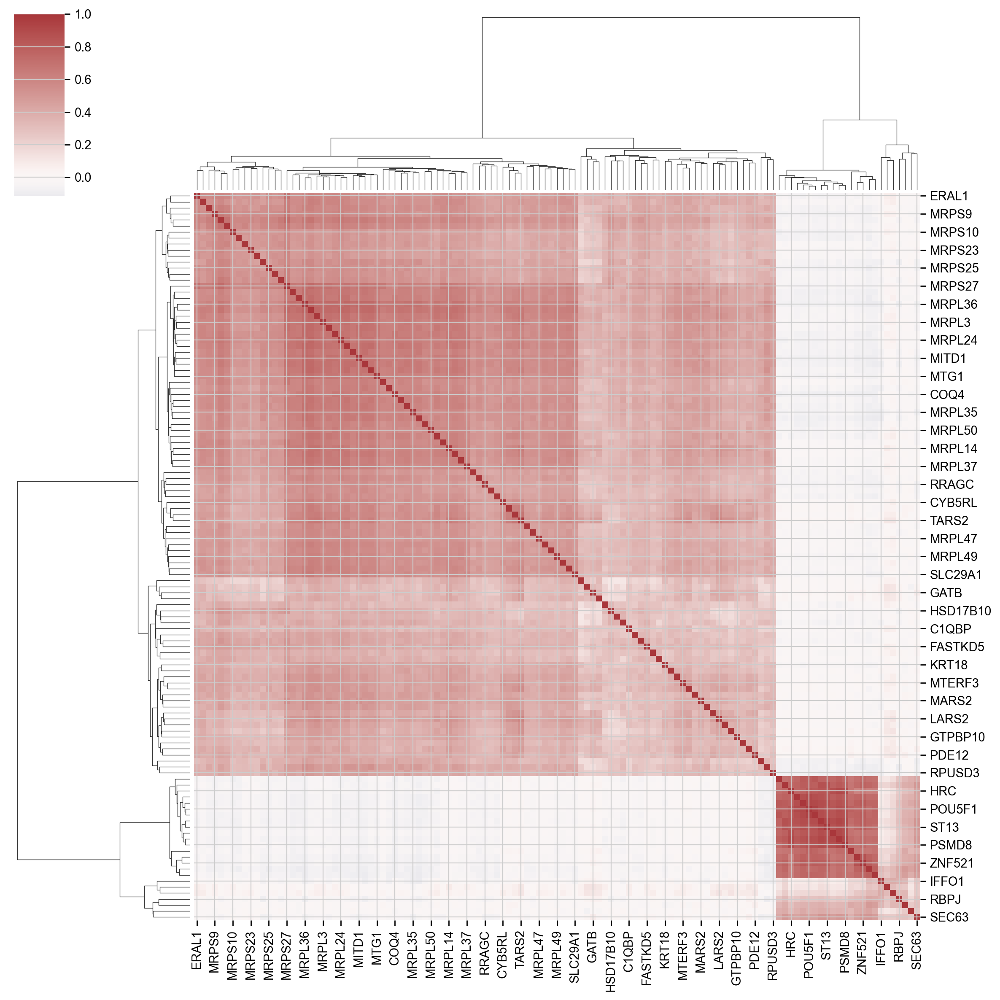

In [62]:
c_20_reduced = [
    "FLYWCH2", "GNG12", "HRC", "IDI1", "IFFO1", "JOSD1", "MARVELD1", "MBD1", "NR1D1", "PHF20",
    "POU3F2", "POU5F1", "POU5F1B", "PSMD8", "PTPN1", "RBM14", "RBPJ", "RNF7", "SEC63", "ST13",
    "STOML1", "SULF2", "ZNF396", "ZNF521", "ZBTB41"
]
c_26 = [
    "AARS2", "ACSF3", "AURKAIP1", "C1QBP", "C19orf84", "CHCHD1", "COQ4", "CYB5RL", "EARS2", "ERAL1", "FASTKD5", "GADD45", "GIP1", "GATB", "GFM1", "GTPBP10", "HSD17B10", "KPNA1", "KRT18", "LARS2", "LFNG", "MARS2", "MITD1", "MRM2", "MRPL3", "MRPL4", "MRPL9", "MRPL10", "MRPL11", "MRPL12", "MRPL14", "MRPL15", "MRPL16", "MRPL17", "MRPL21", "MRPL22", "MRPL23", "MRPL24", "MRPL27", "MRPL28", "MRPL30", "MRPL34", "MRPL35", "MRPL36", "MRPL37", "MRPL38", "MRPL39", "MRPL40", "MRPL41", "MRPL42", "MRPL43", "MRPL44", "MRPL47", "MRPL49", "MRPL50", "MRPL53", "MRPL55", "MRPL58", "MRPS2", "MRPS7", "MRPS9", "MRPS10", "MRPS12", "MRPS14", "MRPS15", "MRPS16", "MRPS17", "MRPS18A", "MRPS18C", "MRPS23", "MRPS25", "MRPS26", "MRPS27", "MRPS34", "MRPS35", "MTERF3", "MTERF4", "MTFMT", "MTG1", "MTIF2", "NAA40", "NARS2", "NDUFB5", "NSUN4", "PARS2", "PDE12", "PRR13", "RBFA", "RPUSD3", "RRAGC", "SAMD10", "SLC29A1", "SUPV3L1", "TARS2", "TRUB2", "TUFM", "UBFD1", "USP4", "ZBTB41"
]
import seaborn as sns

# Combine c_20 and c_26 into a single list of genes to plot
genes_to_plot = c_20 + c_26

# Filter the correlation matrix to only include these genes (rows and columns)
filtered_corrs = perturb_corrs.loc[perturb_corrs.index.intersection(genes_to_plot), perturb_corrs.columns.intersection(genes_to_plot)]

# Plot the clustermap
sns.clustermap(filtered_corrs, figsize=(12, 12), cmap="vlag", center=0)
plt.show()

/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/seaborn/matrix.py:1124: UserWarning: ``square=True`` ignored in clustermap


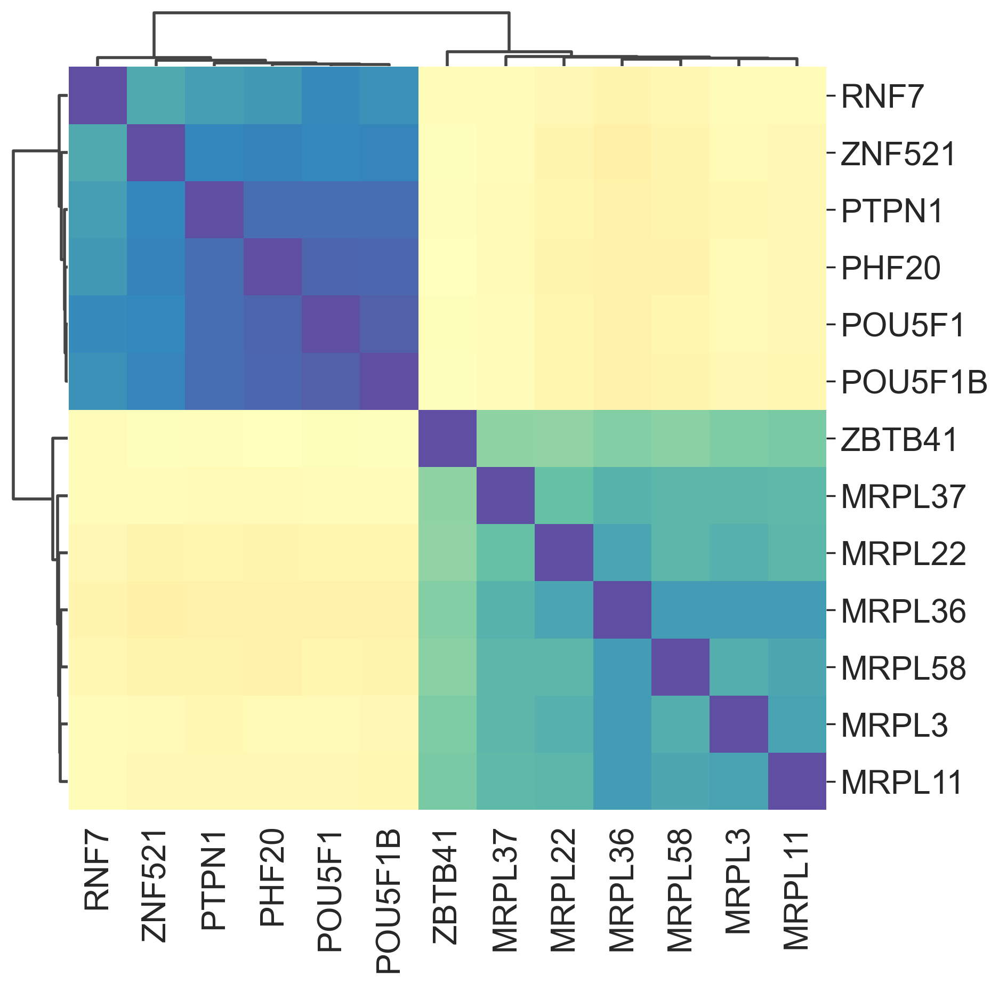

In [100]:

import seaborn as sns
import matplotlib.pyplot as plt

c20_reduced_genes = ["RNF7", "POU5F1", "POU5F1B", "PHF20", "PTPN1", "ZNF521"]
c26_reduced_genes = ["MRPL3", "MRPL11", "MRPL22", "MRPL36", "MRPL37", "MRPL58", "ZBTB41"]
genes_to_plot = c20_reduced_genes + c26_reduced_genes
filtered_corrs = perturb_corrs.loc[perturb_corrs.index.intersection(genes_to_plot), perturb_corrs.columns.intersection(genes_to_plot)]

# Global style with larger font
sns.set(context="notebook", style="white", font_scale=2.0)

# Draw clustermap with NO colorbar
g = sns.clustermap(
    filtered_corrs,
    figsize=(9, 10),
    cmap="Spectral",
    vmin=-1, vmax=1,
    center=0,
    square=True,
    linewidths=0,
    dendrogram_ratio=(0.07, 0.07),
    tree_kws={"linewidths": 2, "color": "#444444"},
    cbar_pos=None   # disable the colorbar
)

# Make the heatmap square by setting aspect ratio


ax.set_frame_on(False)
ax.tick_params(left=False, bottom=False, labelsize=22)  # Make tick labels bigger
for lbl in ax.get_xticklabels():
    lbl.set_rotation(90)
    lbl.set_ha("right")
    lbl.set_fontweight("normal")
    lbl.set_fontsize(22)
for lbl in ax.get_yticklabels():
    lbl.set_fontweight("normal")
    lbl.set_fontsize(22)

# Adjust margins so labels aren’t clipped
plt.subplots_adjust(left=0.1, right=0.95, top=0.9, bottom=0.15)
plt.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/c20_c26_corrs_clustermap.svg')
plt.show()


In [101]:
perturb_corrs

,AARS2,ABCF1,ABHD8,ABHD17A,ABI2,ABL2,ACAP3,ACLY,ACOT8,ACOT13,...,ZNF521,ZNF532,ZNF561,ZNF562,ZNF572,ZNF695,ZNF787,ZNF888,ZNRF1,ZSWIM4
AARS2,1.000000,0.102756,0.029499,0.007901,0.027633,0.016203,0.035279,0.016528,0.050049,0.017136,...,-0.007837,0.050838,0.040447,-0.012938,0.088585,0.060910,0.095715,0.071795,-0.017044,0.008326
ABCF1,0.102756,1.000000,-0.008779,-0.097041,0.081854,-0.108724,-0.035389,-0.110087,0.002639,-0.038362,...,-0.079142,0.078309,0.048546,-0.014703,0.014720,-0.003634,-0.008338,-0.097757,-0.098115,0.143580
ABHD8,0.029499,-0.008779,1.000000,0.107616,0.049155,0.041242,0.081324,0.042224,0.124627,0.093694,...,0.065881,0.011566,0.047026,0.051928,0.084351,0.104374,0.128653,0.109278,0.094928,0.093000
ABHD17A,0.007901,-0.097041,0.107616,1.000000,0.041483,0.113093,0.144169,0.118027,0.107361,0.074058,...,0.050011,0.037105,0.073708,0.061543,0.081783,0.163621,0.158241,0.190420,0.123745,0.039060
ABI2,0.027633,0.081854,0.049155,0.041483,1.000000,0.020967,0.054697,0.010493,0.074424,0.027473,...,-0.005585,0.087806,0.018632,0.029324,0.049632,0.074584,0.061952,0.034640,0.091357,0.044981
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF695,0.060910,-0.003634,0.104374,0.163621,0.074584,0.093907,0.157689,0.061489,0.106837,0.098681,...,0.050829,0.037704,0.063606,0.046168,0.111485,1.000000,0.160284,0.194977,0.131716,0.034017
ZNF787,0.095715,-0.008338,0.128653,0.158241,0.061952,0.097294,0.165961,0.122232,0.147923,0.130852,...,0.008978,0.113590,0.071340,0.096061,0.105453,0.160284,1.000000,0.215697,0.115928,0.079926
ZNF888,0.071795,-0.097757,0.109278,0.190420,0.034640,0.124969,0.177189,0.116754,0.152017,0.108615,...,0.066562,0.036164,0.082188,0.053072,0.144169,0.194977,0.215697,1.000000,0.187564,0.020415
ZNRF1,-0.017044,-0.098115,0.094928,0.123745,0.091357,0.111284,0.117072,0.105064,0.080285,0.102841,...,0.050510,0.023626,0.019035,0.070610,0.109565,0.131716,0.115928,0.187564,1.000000,-0.022898
